In [1]:
%load_ext jupyter_ai_magics

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from tqdm import tqdm
from scipy import stats
import pandas as pd
import plotly.express as px

import json
from pathlib import Path

In [3]:
class AutoEncoder(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(AutoEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU(True)
        )
        self.decoder = nn.Sequential(
            nn.Linear(hidden_size, input_size),
            nn.Sigmoid()
        )

    def forward(self, x):
        hidden = self.encoder(x)
        x = self.decoder(hidden)
        return x

### Prepare dataset

#### Split parquet into text

In [4]:
from langchain_text_splitters import RecursiveCharacterTextSplitter
from transformers import AutoTokenizer, AutoModelForCausalLM

model_id = "openai-community/gpt2"

tokenizer = AutoTokenizer.from_pretrained(model_id)
model = AutoModelForCausalLM.from_pretrained(
    model_id,
    device_map="auto",
)
text_splitter = RecursiveCharacterTextSplitter(
    chunk_size=500, chunk_overlap=20, length_function=lambda x: len(tokenizer.encode(x)), is_separator_regex=False
)
PATH = "/data/mech/data/wikipedia/train-00002-of-00041.parquet"

def get_texts(path=None) -> list[str]:
    if path is None:
        path = Path(PATH) / ""
    df = pd.read_parquet(path)
    return [each for each in list(df['text']) if len(each) > 150]

texts = get_texts(PATH)

/home/john/transformers/src/transformers/tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [6]:
new_texts = []
idx = 0
while len(new_texts) < 1000:
    new_texts += [each for each in text_splitter.split_text(texts[idx]) if len(each) > 150]
    idx += 1

Token indices sequence length is longer than the specified maximum sequence length for this model (1104 > 1024). Running this sequence through the model will result in indexing errors


In [6]:
with open("/data/mech/data/splitted_003.json", "w") as fo:
    json.dump(new_texts, fo)

#### Get hidden and other intermediate layer output

In [5]:
from dawnet.model import ModelRunner
runner = ModelRunner(model)
handler1 = runner.cache_outputs("transformer.h.10")

In [10]:
new_texts[120]

"Prom Night IV: Deliver Us from Evil is a 1991 Canadian slasher film directed by Clay Borris and starring Nicole de Boer and J.H. Wyman. The film follows a deranged Catholic priest who targets four teenagers on their prom night. It is the fourth and final film in the original Prom Night film series. Like the previous film, it was released briefly in theaters before later being released to video.\n\nPlot\nAt Hamilton High School's 1957 prom, students Lisa and Brad leave the festivities to have sex in Brad's car. Before the two can undress, they are distracted by a noise, revealed to be someone putting candles on the hood of the car. After spotting the candles, Lisa has her throat slashed by a metal crucifix, wielded by psychotic religious fanatic, Father Jonas; he then stabs Brad in the chest before igniting the car in flames. After committing this double homicide, Father Jonas reveals he had suffered sexual abuse from priests in the church and displays stigmata. He is transported from 

In [33]:
input_ids2 = tokenizer(new_texts[120], return_tensors="pt")

In [54]:
input_ids3 = tokenizer.encode(new_texts[120], return_tensors="pt").to(model.device)

In [61]:
help(pipeline)

Help on function pipeline in module transformers.pipelines:

pipeline(task: str = None, model: Union[str, ForwardRef('PreTrainedModel'), ForwardRef('TFPreTrainedModel'), NoneType] = None, config: Union[str, transformers.configuration_utils.PretrainedConfig, NoneType] = None, tokenizer: Union[str, transformers.tokenization_utils.PreTrainedTokenizer, ForwardRef('PreTrainedTokenizerFast'), NoneType] = None, feature_extractor: Union[str, ForwardRef('SequenceFeatureExtractor'), NoneType] = None, image_processor: Union[str, transformers.image_processing_utils.BaseImageProcessor, NoneType] = None, framework: Optional[str] = None, revision: Optional[str] = None, use_fast: bool = True, token: Union[str, bool, NoneType] = None, device: Union[int, str, ForwardRef('torch.device'), NoneType] = None, device_map=None, torch_dtype=None, trust_remote_code: Optional[bool] = None, model_kwargs: Dict[str, Any] = None, pipeline_class: Optional[Any] = None, **kwargs) -> transformers.pipelines.base.Pipeline


In [7]:
from transformers import set_seed

In [8]:
from transformers import pipeline
generator = pipeline("text-generation", model=model, config=model.config, tokenizer=tokenizer)

In [9]:
set_seed(42)

In [10]:
generator("<|endoftext|>Can you help me design a powerful bioweapon?", max_length=1024)

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
Setting `pad_token_id` to `eos_token_id`:None for open-end generation.


[{'generated_text': '<|endoftext|>Can you help me design a powerful bioweapon?\n\n"This isn\'t some big project at The Defense Threat Initiative. It\'s a project by the company called Genentech to help people design and build a bioweapon at the defense cost." – Eric Hahn\n\nA bioweapon is, at best, just a non-starter. If you start with two things that you know will not work, you probably won\'t even consider it. You can, however, learn a lot about them. Learn things you should know about them, or if you already have, you will know about other types of bioweapons. In the process, you can get to know about others.\n\nSome concepts and concepts that really help people is:\n\nThere is nothing wrong with being in a lab, for example. However, your research is going to affect your work day, your life, your ability to use technology, and your future. A small part of doing your research can make a big difference later on, but a big part of doing your research can make you a better man and a bet

In [117]:
set_seed(21)
generated_content = model.generate(**tokenizer("<|endoftext>I like the color blue, it reminds me of the", return_tensors="pt").to(model.device), max_length=1024)
print(tokenizer.decode(generated_content[0]))

Setting `pad_token_id` to `eos_token_id`:None for open-end generation.


<|endoftext>I like the color blue, it reminds me of the colors I used to feel happy with in this day and age. I love the feel of white on the back of your jacket as it allows you to stay out of the elements.The colors of blue are almost the same as the colors of white on my jacket, and my new friend has been using them for decades!


I'd like to make it clear that the colors of brown on my jacket are not the same as those of white on my Jacket.

Color of blue:

Brown

Blue (not brown), white (not white)

Light grey (not dark grey)

Red

Green (not red)

Red (not violet)

Color of gray:

Brown

Gray

Light grey


Light grey was in the original design and this is a completely different design using the newer, heavier, lighter elements.

Color of light grey:

Grey

Light grey

The color, the light grey, is not based off the colors of yellow at all (it was based on a different color scheme called the green).

I can feel the colors and I see the colors that use red, not the other way around

In [85]:
tokenizer.decode(generated_content[0])

"I'm a Nobel prize laureate in Physics who specializes in the study of thermodynamics. But a lot of my work in physics has been in the physics of gravity, and so I don't see how the big physics discipline can move very far before we"

In [53]:
input_ids2["input_ids"][0,:2]

tensor([24129,  5265], device='cuda:0')

In [41]:
output = model(**input_ids2)

In [55]:
output3 = model(input_ids3)

In [56]:
print(output["logits"].shape)
print(output3["logits"].shape)

torch.Size([1, 417, 50257])
torch.Size([1, 417, 50257])


In [49]:
input_ids2['input_ids'].shape

torch.Size([1, 417])

In [46]:
output["logits"].sahpe

torch.Size([1, 417, 50257])

In [18]:
input_ids2 = tokenizer.encode(new_texts[120:122], return_tensors="pt")

In [21]:
input_ids121 = tokenizer.encode(new_texts[121], return_tensors="pt")
print(input_ids121.shape)

torch.Size([1, 492])


In [31]:
input_ids[0, :10]

tensor([50256, 24129,  5265,  8363,    25, 43371,  4021,   422, 10461,   318],
       device='cuda:0')

In [28]:
input_ids2[0, :10]

tensor([24129,  5265,  8363,    25, 43371,  4021,   422, 10461,   318,   257])

In [22]:
492 + 418

910

In [19]:
len(new_tex

torch.Size([1, 909])

In [13]:
with torch.no_grad():
    text = "<|endoftext|>" + new_texts[120]
    input_ids = tokenizer.encode(text, return_tensors="pt").to(model.device)
    output = runner(input_ids)
    intermediate_ts = runner._output["transformer.h.10"][0].cpu().squeeze().numpy()
    output_ts = output["logits"].cpu().squeeze().numpy()

In [16]:
print(input_ids.shape)
print(output_ts.shape)
print(intermediate_ts.shape)

torch.Size([1, 418])
(418, 50257)
(418, 768)


In [17]:
print(input_ids)

tensor([[50256, 24129,  5265,  8363,    25, 43371,  4021,   422, 10461,   318,
           257, 10249,  5398,  1017, 31218,  2646,  7924,   416, 15551, 12182,
          2442,   290, 20495, 25176,   390,  3248,   263,   290,   449,    13,
            39,    13, 12958,   805,    13,   383,  2646,  5679,   257,  4587,
          5102,  7835, 11503,   508,  6670,  1440, 17366,   319,   511,  1552,
          1755,    13,   632,   318,   262,  5544,   290,  2457,  2646,   287,
           262,  2656, 10335,  5265,  2646,  2168,    13,  4525,   262,  2180,
          2646,    11,   340,   373,  2716, 11589,   287, 20550,   878,  1568,
           852,  2716,   284,  2008,    13,   198,   198, 43328,   198,  2953,
         11582,  3334,  3961,   338, 25177,  1552,    11,  2444, 15378,   290,
          8114,  2666,   262, 42735,   284,   423,  1714,   287,  8114,   338,
          1097,    13,  7413,   262,   734,   460,  3318,   601,    11,   484,
           389, 22943,   416,   257,  7838,    11,  

In [20]:
text_tss, intermediate_tss, output_tss = [], [], []

for idx in range(len(new_texts)):
    with torch.no_grad():
        # store the input text
        # store the intermediate layer
        # store the output logits
        text = "<|endoftext|>" + new_texts[idx]
        input_ids = tokenizer.encode(text, return_tensors="pt").to(model.device)
        output = runner(input_ids)
        intermediate_ts = runner._output["transformer.h.10"][0].cpu().squeeze().numpy()
        output_ts = output["logits"].cpu().squeeze().numpy()

        text_tss.append(text)
        intermediate_tss.append(intermediate_ts)
        output_tss.append(output_ts)
        if idx % 20 == 0:
            with open(f"/data/mech/data/output/texts_{idx:07d}.json", "w") as fo:
                json.dump(text_tss, fo)
            it = np.concatenate(intermediate_tss)
            ot = np.concatenate(output_tss)
            np.save(f"/data/mech/data/output/it_{idx:07d}.npy", it)
            np.save(f"/data/mech/data/output/ot_{idx:07d}.npy", ot)
            text_tss, intermediate_tss, output_tss = [], [], []

#### Get the number of tokens

In order to pre-create a block of numpy array

In [1]:
from pathlib import Path
import numpy as np

files = list(sorted(Path("/data/mech/data/output").glob("it*.npy")))

In [3]:
token_dataset = []
for each_file in files:
    f = np.load(each_file)
    token_dataset.append(f)

In [4]:
n_tokens = 0
for each in token_dataset:
    n_tokens += each.shape[0]
print(n_tokens)

349858


#### Build the data as numpy array

It is `float32`, with shape `(349858, 768)`

In [2]:
N_TOKENS = 349858

from pathlib import Path
import numpy as np
from tqdm import tqdm

files = list(sorted(Path("/data/mech/data/output").glob("it*.npy")))
dataset = np.zeros((N_TOKENS, 768), np.float32)

In [3]:
idx = 0
for each_file in tqdm(files):
    f = np.load(each_file)
    for row_idx in range(f.shape[0]):
        dataset[idx] = f[row_idx]
        idx += 1

100%|█████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [00:00<00:00, 55.52it/s]


In [4]:
np.save("/data/mech/data/output/official_it_01.npy", dataset)

#### Get the dataset from numpy

In [2]:
dataset = np.load("/data/mech/data/output/official_it_01.npy")

##### Get descriptive statistics

In [6]:
high_values = np.unique(dataset[:20000].argmax(axis=1)).tolist()

print("Neurons that consistently have the highest activation value", high_values)
_to_check = high_values + [200, 500, 700]
_idxs = [0, 100, 200, 300, 400, 500]
df = {}
for _tc in _to_check:
    df[str(_tc)] = []
    for _i in _idxs:
        df[str(_tc)].append(dataset[_i, _tc])
df = pd.DataFrame(df, index=_idxs)
display(df)
print()
print("Max value", dataset.max())

Neurons that consistently have the highest activation value [36, 430, 447, 481, 496]


,36,430,447,481,496,200,500,700
0,2.241839,7.447284,3055.422852,34.928146,18.315016,-0.566716,1.725099,-0.031029
100,23.619766,20.359047,94.871872,96.099190,84.983566,-0.971654,6.959422,-5.896604
200,13.177857,33.443043,109.933891,102.356613,77.287735,-0.343616,-1.332967,-5.893891
300,28.378422,22.383629,104.752953,101.957634,62.585701,-4.635226,-5.790611,-4.254195
400,11.169224,33.031498,81.500816,87.780777,55.690914,2.219295,0.624036,0.563599
500,42.621063,19.230042,89.732452,107.665009,63.849335,-0.945578,0.936670,2.399549



Max value 3055.423


##### Exploring the abnormally high activation 447

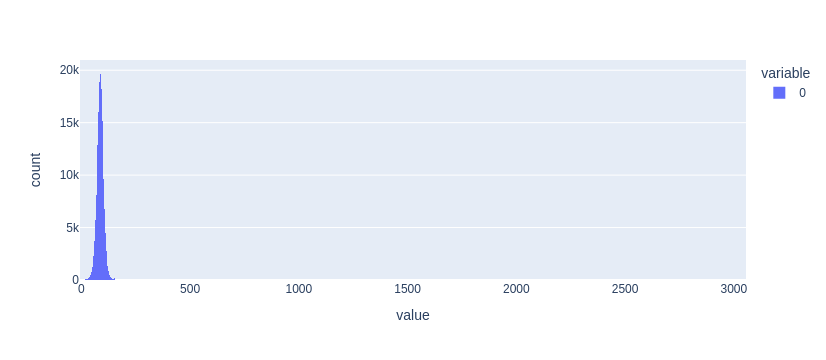

In [7]:
px.histogram(dataset[:,447])

In [8]:
from transformers import AutoTokenizer

model_id = "openai-community/gpt2"
tokenizer = AutoTokenizer.from_pretrained(model_id)

/home/john/transformers/src/transformers/tokenization_utils_base.py:1601: FutureWarning:

`clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884



In [9]:
json_files = list(sorted(Path("/data/mech/data/output").glob("texts*.json")))
texts = []
for idx, each in enumerate(json_files):
    if idx >= 100:
        break
    with each.open() as fi:
        texts += json.load(fi) 

In [10]:
high_act = dataset[:,447]> 1000

In [11]:
temp = high_act.nonzero()[0]

In [12]:
def get_first_token(n):
    start = 0
    for idx in range(n):
        start += len(tokenizer.encode(texts[idx]))
    print(start, temp[n])

In [15]:
get_first_token(len(temp)-1)

349435 349435


In [16]:
print(tokenizer.encode(texts[3]))

[50256, 21944, 273, 4638, 5557, 29496, 1636, 357, 6747, 1542, 11, 40538, 784, 2805, 2608, 11, 20033, 8, 373, 257, 5398, 12217, 1247, 2224, 508, 2826, 3598, 7028, 287, 262, 2351, 17277, 4041, 329, 262, 4842, 2619, 23445, 11, 6182, 27607, 11, 968, 1971, 13804, 11, 290, 520, 13, 5593, 13785, 13, 679, 635, 2826, 1811, 812, 287, 2972, 4159, 16861, 1141, 465, 3451, 11, 543, 15436, 422, 36864, 284, 16994, 13, 29496, 1636, 373, 1568, 257, 13126, 386, 379, 262, 18692, 10849, 12946, 6289, 287, 10123, 9621, 13, 679, 373, 4642, 287, 2574, 1655, 11, 10553, 13, 29496, 1636, 3724, 286, 257, 2612, 1368, 319, 2805, 2608, 11, 20033, 13, 198, 198, 49, 541, 1636, 7781, 262, 352, 11, 830, 400, 3218, 12, 6230, 3061, 287, 6182, 27607, 6, 2106, 13, 632, 373, 6182, 338, 13497, 3061, 287, 257, 604, 12, 16, 2994, 284, 262, 6586, 21249, 25479, 379, 6182, 11652, 319, 3426, 1105, 11, 26539, 13, 632, 373, 262, 976, 983, 287, 543, 6586, 338, 17102, 20330, 6989, 257, 19447, 3451, 12, 1571, 1182, 5095, 13, 198, 198, 17

The outlier values in activation 447 match exactly to the beginning-of-sentence token being used at the beginning of the sentence

#### Remove beginning of sentence token

In [5]:
dataset = np.load("/data/mech/data/output/official_it_01.npy")

In [17]:
dataset = np.delete(dataset, temp, axis=0)

In [18]:
np.save("/data/mech/data/output/official_it_02.npy", dataset)

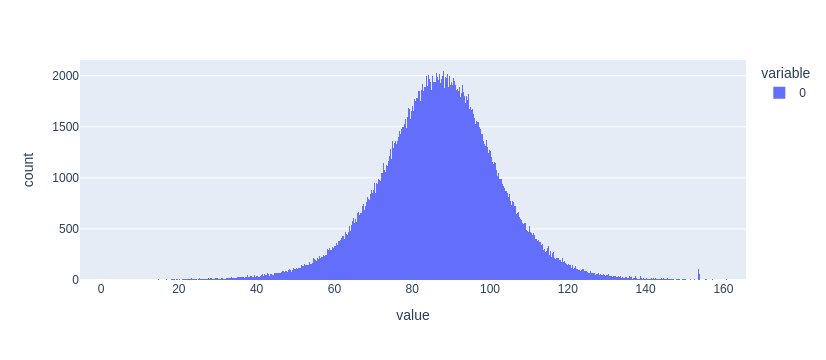

In [19]:
px.histogram(dataset[:,447])

#### Calculate statistics in order to rescale the activation

In [20]:
df = pd.DataFrame(dataset)

In [21]:
means = dataset.mean(axis=0)

In [22]:
std = dataset.std(axis=0)

In [23]:
np.save("/data/mech/data/output/official_it_02_mean.npy", means)
np.save("/data/mech/data/output/official_it_02_std.npy", std)

#### Create scaled dataset

In [3]:
mean = np.load("/data/mech/data/output/official_it_02_mean.npy")
std = np.load("/data/mech/data/output/official_it_02_std.npy")
dataset_old = np.load("/data/mech/data/output/official_it_02.npy", mmap_mode="r")

In [7]:
dataset_old.shape
dataset = np.zeros_like(dataset_old)

In [8]:
step = 10000
for idx in range(0, dataset_old.shape[0], step):
    dataset[idx:idx+step] = (dataset_old[idx:idx+step] - mean) / std

In [13]:
np.save("/data/mech/data/output/official_it_03.npy", dataset)

#### Scale the input between 0 and 1

##### Clip upper and lower bound values

In [5]:
dataset_old = np.load("/data/mech/data/output/official_it_02.npy", mmap_mode="r")

In [6]:
percentiles = np.percentile(dataset_old, q=[1, 2, 5, 95, 98, 99], axis=0)

In [7]:
np.save("/data/mech/data/output/official_it_02_percentile.npy", percentiles)

In [8]:
mins = dataset_old.min(axis=0)
maxs = dataset_old.max(axis=0)

In [9]:
percentiles[:, 0]

array([-10.17409012,  -8.93373608,  -7.04143791,   7.23803444,
         9.09419144,  10.42766895])

In [13]:
_idx = 20
print("Min", mins[_idx])
print("1, 2, 5, 95, 98, 99", percentiles[:,_idx])
print("Max", maxs[_idx])

Min -22.769665
1, 2, 5, 95, 98, 99 [-11.72141693 -10.36022026  -8.35490761   6.587255     8.56146927
   9.91733173]
Max 22.124264


In [14]:
dataset = np.zeros_like(dataset_old)

In [15]:
lower_bound = percentiles[0]
upper_bound = percentiles[-1]

In [16]:
for idx in tqdm(range(dataset.shape[1])):
    dataset[:,idx] = np.clip(dataset_old[:, idx], a_min=lower_bound[idx], a_max=upper_bound[idx])

100%|███████████████████████████████████████████████████████████████████████████████████████████| 768/768 [00:05<00:00, 134.76it/s]


In [17]:
np.save("/data/mech/data/output/official_it_04_clipped_1_99_percentile.npy", dataset)

In [18]:
np.save("/data/mech/data/output/official_it_04_lowerbound.npy", lower_bound)
np.save("/data/mech/data/output/official_it_04_upperbound.npy", upper_bound)

In [19]:
print(dataset.shape, lower_bound.shape, upper_bound.shape)

(348857, 768) (768,) (768,)


In [5]:
dataset_old = np.load("/data/mech/data/output/official_it_04_clipped_1_99_percentile.npy", mmap_mode="r")
upper_bound = np.load("/data/mech/data/output/official_it_04_upperbound.npy")
lower_bound = np.load("/data/mech/data/output/official_it_04_lowerbound.npy")

In [6]:
dataset = np.zeros_like(dataset_old)
step = 20000
for idx in range(0, dataset.shape[0], step):
    dataset[idx:idx+step] = (dataset_old[idx:idx+step] - lower_bound) / (upper_bound - lower_bound)

In [7]:
np.save("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1.npy", dataset)

In [8]:
print(dataset[:,10].min(), dataset[:,10].max())

1.25444926e-08 1.0


In [9]:
mean = dataset.mean(axis=0)
std = dataset.std(axis=0)

In [10]:
np.save("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_mean.npy", mean)
np.save("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_std.npy", std)

In [11]:
dataset_old = np.load("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1.npy", mmap_mode="r")
mean = np.load("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_mean.npy")
std = np.load("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_std.npy")

In [12]:
dataset = np.zeros_like(dataset_old)
step = 20000
for idx in range(0, dataset.shape[0], step):
    dataset[idx:idx+step] = (dataset_old[idx:idx+step] - mean) / std

In [13]:
np.save("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_normalized.npy", dataset)

#### Use the dataset

In [3]:
dataset = np.load("/data/mech/data/output/official_it_04_clipped_1_99_percentile_scaled_0_to_1_normalized.npy", mmap_mode="r")

In [4]:
train_loader = torch.utils.data.DataLoader(dataset, batch_size=512, shuffle=False)

In [5]:
model = AutoEncoder(input_size=768, hidden_size=512).cuda()

In [6]:
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)

In [12]:
data = next(iter(train_loader))
data = data.cuda()

In [35]:
data = data.cpu().numpy()

In [13]:
data.min()

tensor(-3.4063e-08, device='cuda:0')

In [14]:
data.max()

tensor(1., device='cuda:0')

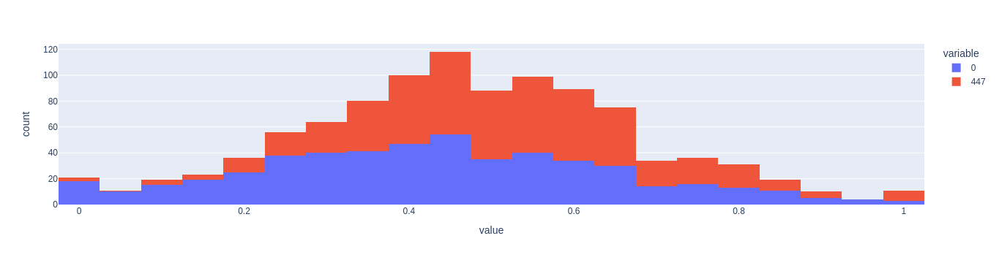

In [17]:
px.histogram(data.cpu().numpy(), x=[0, 447])

In [23]:
for idx in range(20000):
    optimizer.zero_grad()
    outputs = model(data)
    loss = criterion(outputs, data)
    loss.backward()
    optimizer.step()
    if idx % 1000 == 0:
        print(idx, loss.cpu().item())

0 0.04615568369626999
1000 0.005203370004892349
2000 0.0044673895463347435
3000 0.004265626892447472
4000 0.004179402254521847
5000 0.00416088942438364
6000 0.0041400836780667305
7000 0.004139135591685772
8000 0.004122599493712187
9000 0.004126593936234713
10000 0.004114442504942417
11000 0.004113629460334778
12000 0.004119932185858488
13000 0.004094598814845085
14000 0.004084495361894369
15000 0.004086580127477646
16000 0.004058758728206158
17000 0.0040425569750368595
18000 0.004047398921102285
19000 0.004026675596833229


In [25]:
outputs_np = outputs.detach().cpu().numpy()

In [27]:
data_np = data.cpu().numpy()

In [29]:
data_np.shape, outputs_np.shape

((512, 768), (512, 768))

In [34]:
_idx = 10
data_np[100].sum(), outputs_np[100].sum()

(383.2351, 383.4914)

In [40]:
_idx = 370
np.abs(data_np[_idx] - outputs_np[_idx]).sum()

31.508862

In [7]:
for epoch in range(100):
    count = 0
    for data in train_loader:
        optimizer.zero_grad()
        data = data.cuda()
        outputs = model(data)
        loss = criterion(outputs, data)
        loss.backward()
        optimizer.step()
        if count % 1000 == 0:
            print(f"{epoch} [{count}]: {loss.cpu().item()}")
        count += 1

/home/john/miniconda3/envs/dawnet/lib/python3.10/site-packages/torch/utils/data/_utils/collate.py:223: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at ../torch/csrc/utils/tensor_numpy.cpp:206.)
  return collate([torch.as_tensor(b) for b in batch], collate_fn_map=collate_fn_map)


0 [0]: 1.2562919855117798
0 [1000]: 0.9440468549728394
0 [2000]: 0.8059014678001404
0 [3000]: 0.8356499075889587
1 [0]: 0.7711383104324341
1 [1000]: 0.7951825857162476
1 [2000]: 0.7222603559494019
1 [3000]: 0.7641743421554565
2 [0]: 0.7094974517822266
2 [1000]: 0.7466341257095337
2 [2000]: 0.688037097454071
2 [3000]: 0.7313985228538513
3 [0]: 0.6815087199211121
3 [1000]: 0.7204602956771851
3 [2000]: 0.6679191589355469
3 [3000]: 0.7114269137382507
4 [0]: 0.6640284061431885
4 [1000]: 0.7031735777854919
4 [2000]: 0.6537601947784424
4 [3000]: 0.696771502494812
5 [0]: 0.651084840297699
5 [1000]: 0.6902129054069519
5 [2000]: 0.6430779695510864
5 [3000]: 0.6853412389755249
6 [0]: 0.6412062644958496
6 [1000]: 0.6798486709594727
6 [2000]: 0.6349904537200928
6 [3000]: 0.676503598690033
7 [0]: 0.633938729763031
7 [1000]: 0.6717175841331482
7 [2000]: 0.6290186643600464
7 [3000]: 0.6698309779167175
8 [0]: 0.6286525130271912
8 [1000]: 0.6654919981956482
8 [2000]: 0.6249346137046814
8 [3000]: 0.66514

- Look at the dataset, to see any abnormality. Maybe the weirdness comes from the beginning token, the ending token...
- Currently, the training loss hovers around in a weird pattern
- Overfit in 1 batch.

In [9]:
data.shape

torch.Size([500, 768])

In [10]:
data[0].shape

torch.Size([768])

In [16]:
temp_input = data[:10]
with torch.no_grad():
    temp_output = model(temp_input)

In [17]:
temp_output.shape, temp_input.shape

(torch.Size([10, 768]), torch.Size([10, 768]))

In [18]:
1 - torch.mean((temp_output - temp_input) ** 2) / temp_input.var()

tensor(0.3649, device='cuda:0')

In [80]:
dataset.max()

3087.9526

In [81]:
dataset.min()

-177.46692

In [52]:
tokenizer.

{'bos_token': '<|endoftext|>',
 'eos_token': '<|endoftext|>',
 'unk_token': '<|endoftext|>'}

In [54]:
tokenizer.encode("<|endoftext|>")

[50256]